# To Detects as Burnt Pizza or Good Pizza

Importing (or installing) Tenosrflow, Keras and other packages on your system

In [ ]:
#!pip install tensorflow==2.2.1

In [ ]:
import tensorflow as tf

In [ ]:
print(tf.__version__)

# Importing all the Packages

In [ ]:
import matplotlib as plt
import matplotlib.pyplot as plt 
%matplotlib inline 

import numpy as np
import pandas as pd
import random
import pickle
import cv2
import os
import time 
import warnings
from imutils import paths 
from tqdm import tqdm_notebook as tqdm
import itertools

warnings.filterwarnings("ignore")
SEED = 42

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix , accuracy_score , classification_report 

from tensorflow.keras.utils import to_categorical 
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense , Dropout 
from tensorflow.keras.optimizers import SGD 

# Loading the data from disk 

In [ ]:
# change working DIR
os.chdir("/content/drive/MyDrive/imarticus Exams Deep Learning")

In [ ]:
!dir

In [ ]:
# Extract dataset.rar file 
!pip install patool

In [ ]:
#import patoolib
#patoolib.extract_archive("PGAWkendDLExam.zip")

In [ ]:
#!dir

In [ ]:
list(paths.list_images("/content/drive/MyDrive/imarticus Exams Deep Learning/PGA Wkend DL Exam/Datasets/ANN/Pizza Refund/train"))[-10:]

In [ ]:
img= cv2.imread("/content/drive/MyDrive/imarticus Exams Deep Learning/PGA Wkend DL Exam/Datasets/ANN/Pizza Refund/train/Good_pizza/good_pizza (90).jpg")

In [ ]:
img.shape

#  initialize the data and labels 

In [ ]:
print("[INFO] loading images...")
time1 = time.time()   # to measure time taken
data = []

labels = []

classes = ["Burnt pizzas", "Good pizzas"]

# grab the image paths and randomly shuffle them
imagePaths = sorted(list(paths.list_images('/content/drive/MyDrive/imarticus Exams Deep Learning/PGA Wkend DL Exam/Datasets/ANN/Pizza Refund/train')))   # data folder with 2 categorical folders
random.seed(SEED)
random.shuffle(imagePaths)

# progress bar 
with tqdm(total=len(imagePaths)) as pbar:
    
    # loop over the input images
    for imagePath in imagePaths:
        # load the image, resize the image to be 32x32 pixels (ignoring aspect ratio), 
        # flatten the 32x32x3=3072 pixel image into a list, and store the image in the data list
        image = cv2.imread(imagePath)
        image = cv2.resize(image, (32, 32)).flatten()
        data.append(image)

        # extract the class label from the image path and update the labels list
        label = imagePath.split(os.path.sep)[-2]
        
        label = 1 if label == "Good_pizza" else 0
        labels.append(label)
        
        # update the progressbar
        pbar.update(1)

# scale the raw pixel intensities to the range [0, 1]
data = np.array(data, dtype="float") / 255.0
labels = np.array(labels)

print('Time taken: {:.1f} seconds'.format(time.time() - time1))   # to measure time taken
print("done")

[INFO] loading images...


  0%|          | 0/709 [00:00<?, ?it/s]

Time taken: 42.7 seconds
done


In [ ]:
print(data[0],labels[0])

[0.3254902  0.25098039 0.22352941 ... 0.33333333 0.30980392 0.29019608] 1


In [ ]:
print("Total Images:", len(data[1]))

Total Images: 3072


In [ ]:
# convert data into dataframe
import pandas as pd
df=pd.DataFrame(data)
df["label"]=labels


In [ ]:
df.shape

(709, 3073)

In [ ]:
df.head()

,0,1,2,3,4,5,6,7,8,9,...,3063,3064,3065,3066,3067,3068,3069,3070,3071,label
0,0.325490,0.250980,0.223529,0.494118,0.423529,0.396078,0.592157,0.521569,0.525490,0.623529,...,0.450980,0.388235,0.364706,0.364706,0.305882,0.294118,0.333333,0.309804,0.290196,1
1,0.631373,0.521569,0.407843,0.619608,0.435294,0.309804,0.482353,0.360784,0.309804,0.541176,...,0.125490,0.082353,0.050980,0.129412,0.062745,0.039216,0.070588,0.035294,0.023529,1
2,0.070588,0.137255,0.129412,0.078431,0.188235,0.274510,0.082353,0.121569,0.156863,0.105882,...,0.525490,0.803922,0.996078,0.686275,0.866667,0.996078,0.690196,0.850980,0.988235,1
3,0.996078,0.996078,0.996078,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,0.270588,0.152941,0.113725,0.223529,0.129412,0.094118,0.168627,0.105882,0.078431,0
4,0.803922,0.823529,0.835294,0.815686,0.835294,0.847059,0.827451,0.847059,0.858824,0.843137,...,0.345098,0.729412,0.866667,0.533333,0.807843,0.929412,0.156863,0.560784,0.843137,1


In [ ]:
df.tail()

,0,1,2,3,4,5,6,7,8,9,...,3063,3064,3065,3066,3067,3068,3069,3070,3071,label
704,0.611765,0.698039,0.745098,0.831373,0.772549,0.709804,0.784314,0.721569,0.670588,0.741176,...,0.019608,0.176471,0.431373,0.003922,0.215686,0.470588,0.003922,0.231373,0.490196,0
705,0.835294,0.819608,0.894118,0.827451,0.800000,0.882353,0.839216,0.803922,0.882353,0.827451,...,0.141176,0.027451,0.827451,0.976471,0.992157,0.988235,0.427451,0.443137,0.447059,1
706,0.788235,0.878431,0.901961,0.823529,0.898039,0.905882,0.894118,0.937255,0.937255,0.929412,...,0.101961,0.094118,0.156863,0.239216,0.364706,0.486275,0.129412,0.168627,0.254902,0
707,0.619608,0.580392,0.552941,0.772549,0.623529,0.552941,0.874510,0.800000,0.741176,0.819608,...,0.752941,0.701961,0.670588,0.760784,0.709804,0.647059,0.745098,0.701961,0.623529,0
708,0.435294,0.670588,0.960784,0.427451,0.674510,0.909804,0.772549,0.847059,0.968627,0.384314,...,0.560784,0.654902,0.725490,0.521569,0.611765,0.698039,0.439216,0.521569,0.600000,1


In [ ]:
df["label"].value_counts()

1    431
0    278
Name: label, dtype: int64

In [ ]:
df["label"].unique()

array([1, 0])

In [ ]:
# sample data for first image
print("sample image: {}".format(data[0]))
print("no of features/pixels values: {}".format(len(data[0]))) # 32x32x3=3072
print("label: {}".format(classes[labels[0]]))

sample image: [0.3254902  0.25098039 0.22352941 ... 0.33333333 0.30980392 0.29019608]
no of features/pixels values: 3072
label: Good pizzas


# Creating your training and testing splits 

In [ ]:
# partition the data into 80% training and 20% validation
(trainX, testX, trainY, testY) = train_test_split(data, labels, test_size=0.2, random_state=SEED)

In [ ]:
print(trainX.shape)
print(trainY.shape)

print(testX.shape)
print(testY.shape)

(567, 3072)
(567,)
(142, 3072)
(142,)


# Data Preprocessing 

#### converting  labels of independent 

In [ ]:
# convert the labels from integers/categories to vectors  

trainY = to_categorical(trainY, num_classes=2)   # fit_transform = find all unique class labels + transform into one-hot encoded labels
testY = to_categorical(testY, num_classes=2)     # transform = perform the one-hot encoding (unique class labels already found)

# [0,1] burnt pizza
# [1,0] good pizzas

In [ ]:
trainY

array([[1., 0.],
       [0., 1.],
       [0., 1.],
       ...,
       [1., 0.],
       [1., 0.],
       [1., 0.]], dtype=float32)

In [ ]:
trainY[10]   #[1,0] good pizzas

array([1., 0.], dtype=float32)

# Define the architecture for ANN

In [ ]:
# define the 3072-1024-512-1 architecture using Keras

model = Sequential()   

# input layer 3072 as there are 32x32x3=3072 pixels in a flattened input image
# first hidden layer has 2057 nodes
model.add(Dense(units= 1536, input_shape=(3072,), kernel_initializer = 'uniform', activation="relu"))  

# dropout for second layer 
model.add(Dropout(0.4))

# second hidden layer has 1021 nodes
model.add(Dense(units=768, kernel_initializer='uniform', activation="relu"))  

# third hidden layer has 1021 nodes
model.add(Dense(units=384, kernel_initializer='uniform', activation="relu")) 

# fourth hidden layer has 1021 nodes
model.add(Dense(units=128, kernel_initializer='uniform', activation="relu")) 

 # output layer with number of possible class labels
model.add(Dense(units=2,kernel_initializer='uniform', activation="softmax"))           

# complie Model

# compiling tensorflow ANN Model

In [ ]:
model.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_22 (Dense)             (None, 1536)              4720128   
_________________________________________________________________
dropout_5 (Dropout)          (None, 1536)              0         
_________________________________________________________________
dense_23 (Dense)             (None, 768)               1180416   
_________________________________________________________________
dense_24 (Dense)             (None, 384)               295296    
_________________________________________________________________
dense_25 (Dense)             (None, 128)               49280     
_________________________________________________________________
dense_26 (Dense)             (None, 2)                 258       
Total params: 6,245,378
Trainable params: 6,245,378
Non-trainable params: 0
____________________________________________

In [ ]:
# initialize our initial learning rate and # of epochs to train for
INIT_LR = 0.01
EPOCHS = 60
 
# compile the model using SGD as our optimizer and categorical cross-entropy loss
# (you'll want to use binary_crossentropy for 2-class classification)
print("[INFO] compiling network network...")
#opt = SGD(lr=INIT_LR)   # Stochastic Gradient Descent (SGD) optimizer
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])

[INFO] compiling network network...


In [ ]:
#model.summary()

# Training your model on your traing data

In [ ]:
# train the neural network on training data set
# batch_size (32) controls the size of each group of data to pass through the network. 

time1 = time.time()   # to measure time taken
H = model.fit(trainX, trainY, validation_data=(testX, testY), epochs=EPOCHS, batch_size=32)
print('Time taken: {:.1f} seconds'.format(time.time() - time1))   # to measure time taken

Epoch 1/60
18/18 [==============================] - 1s 55ms/step - loss: 0.6815 - accuracy: 0.5996 - val_loss: 0.6354 - val_accuracy: 0.5704
Epoch 2/60
18/18 [==============================] - 1s 50ms/step - loss: 0.5343 - accuracy: 0.7090 - val_loss: 0.5558 - val_accuracy: 0.7113
Epoch 3/60
18/18 [==============================] - 1s 47ms/step - loss: 0.5104 - accuracy: 0.7601 - val_loss: 0.5605 - val_accuracy: 0.7465
Epoch 4/60
18/18 [==============================] - 1s 48ms/step - loss: 0.4702 - accuracy: 0.7813 - val_loss: 0.5272 - val_accuracy: 0.7113
Epoch 5/60
18/18 [==============================] - 1s 49ms/step - loss: 0.4408 - accuracy: 0.7743 - val_loss: 0.5499 - val_accuracy: 0.7183
Epoch 6/60
18/18 [==============================] - 1s 48ms/step - loss: 0.4242 - accuracy: 0.7972 - val_loss: 0.5236 - val_accuracy: 0.7183
Epoch 7/60
18/18 [==============================] - 1s 48ms/step - loss: 0.3750 - accuracy: 0.8360 - val_loss: 0.5578 - val_accuracy: 0.6901
Epoch 8/60
18

In [ ]:
# evaluate the network
print("[INFO] evaluating network...")
pred_prob = model.predict(testX, batch_size=32)

[INFO] evaluating network...


In [ ]:
pred_prob

array([[6.0646022e-07, 9.9999940e-01],
       [2.8384214e-03, 9.9716163e-01],
       [1.6414747e-06, 9.9999833e-01],
       [9.0880251e-01, 9.1197453e-02],
       [1.0000000e+00, 2.6463414e-09],
       [1.6022364e-02, 9.8397762e-01],
       [9.9999440e-01, 5.5531532e-06],
       [9.7069418e-01, 2.9305883e-02],
       [8.9652734e-03, 9.9103469e-01],
       [3.3593398e-05, 9.9996638e-01],
       [9.5477271e-01, 4.5227285e-02],
       [2.9527932e-01, 7.0472068e-01],
       [1.1672365e-03, 9.9883276e-01],
       [7.0831662e-01, 2.9168335e-01],
       [2.2731232e-03, 9.9772686e-01],
       [7.5531134e-04, 9.9924469e-01],
       [2.1966039e-03, 9.9780339e-01],
       [2.4850315e-05, 9.9997520e-01],
       [6.0483748e-01, 3.9516249e-01],
       [9.9998128e-01, 1.8767760e-05],
       [3.5649794e-03, 9.9643505e-01],
       [4.3967148e-07, 9.9999952e-01],
       [9.9800092e-01, 1.9991221e-03],
       [9.9999964e-01, 3.5602088e-07],
       [8.6910002e-02, 9.1308999e-01],
       [1.3172369e-03, 9.

# Convert testY and y_pred into 1"s and 0 for classification report 

In [ ]:
# Note : Good pizza -> 1 and Baked Pizza->0

In [ ]:
test_y=[np.argmax(i) for i in testY]
pred_Y=[np.argmax(i) for i in pred_prob]

In [ ]:
pred_Y

# Confussion matrix 

In [ ]:
def plot_confusion_metrix(y_true, y_pred,classes,
                         normalize=False,
                         title='Confusion Matrix',
                         cmap=plt.cm.Blues):
    """
    Objective
    ----------
    plot confussion matrix, classification report and accuracy score
    
    parameters
    ----------
    y_true : array-like of shape (n_samples,)
        Ground truth (correct) target values.

    y_pred : array-like of shape (n_samples,)
        Estimated targets as returned by a classifier.
    
    classes : list
        List of labels to index the matrix
        
    title : title for matrix
    cmap : colormap for matrix 
    
    returns 
    ----------
   all accruacy matrix 
    """
    
    
    cm = confusion_matrix(y_true,y_pred)
    
    
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized Confusion Matrix")
    else:
        print("Confusion Matrix, Without Normalisation")

    
    plt.imshow(cm, interpolation='nearest',cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks,classes,rotation=35)
    plt.yticks(tick_marks,classes)
    
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() /2.
    
    for i , j in itertools.product(range(cm.shape[0]), range(cm.shape[0])):
        plt.text(j, i, format(cm[i,j], fmt),
                 horizontalalignment='center',
                 color='white' if cm[i, j] > thresh else 'black')
    
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    # plt.tight_layout()
    
    plt.show()
    
    print("-----------------------------------------------------")
    print('Classification report')
    print(classification_report(y_true,y_pred))
    
    print("-----------------------------------------------------")
    acc= accuracy_score(y_true,y_pred)
    print("Accuracy of the model: ", acc)

Confusion Matrix, Without Normalisation


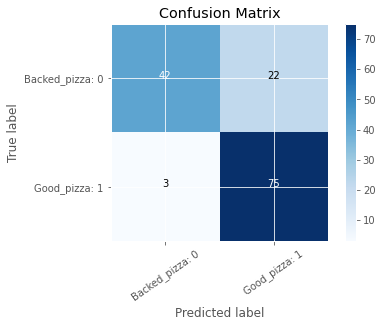

-----------------------------------------------------
Classification report
              precision    recall  f1-score   support

           0       0.93      0.66      0.77        64
           1       0.77      0.96      0.86        78

    accuracy                           0.82       142
   macro avg       0.85      0.81      0.81       142
weighted avg       0.85      0.82      0.82       142

-----------------------------------------------------
Accuracy of the model:  0.823943661971831


In [ ]:
plot_confusion_metrix(test_y, pred_Y,classes=["Backed_pizza: 0","Good_pizza: 1"])

# Generate Plots for acc and val

### validation Plot Loss 

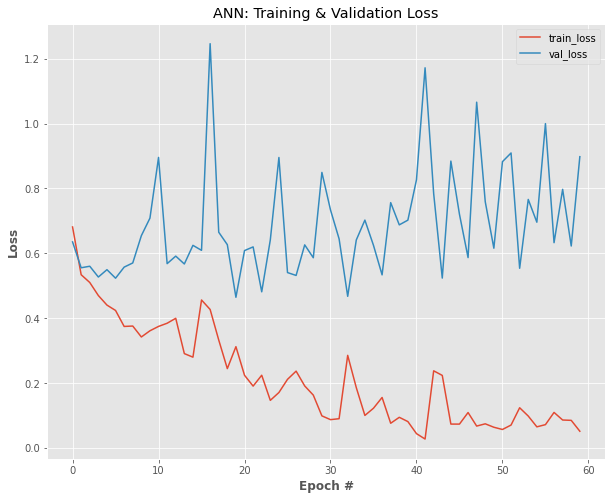

In [ ]:
# plot the training and validation loss
N = np.arange(0, EPOCHS)
plt.style.use("ggplot")
plt.figure(figsize = [10,8])
plt.plot(N, H.history["loss"], label="train_loss")
plt.plot(N, H.history["val_loss"], label="val_loss")
plt.title("ANN: Training & Validation Loss")
plt.xlabel("Epoch #", weight="bold")
plt.ylabel("Loss", weight="bold")
plt.legend()
plt.show()

#### Validation Accuracy 

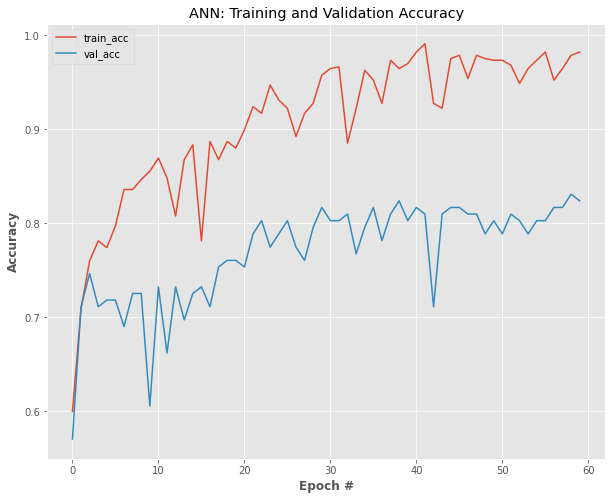

In [ ]:
# plot the training and validation accuracy
N = np.arange(0, EPOCHS)
plt.style.use("ggplot")
plt.figure(figsize = [10,8])
plt.plot(N, H.history["accuracy"], label="train_acc")
plt.plot(N, H.history["val_accuracy"], label="val_acc")
plt.title("ANN: Training and Validation Accuracy")
plt.xlabel("Epoch #", weight="bold")
plt.ylabel("Accuracy", weight="bold")
plt.legend()
plt.show()

# saveing  the model and 

In [ ]:
print("[INFO] serializing network and labels binarizer....")
model.save("model_ANN.h5")

[INFO] serializing network and labels binarizer....


# Makeing predictions using your trained tensorflow model 

In [ ]:
# import the necessary packages
from tensorflow.keras.models import load_model
import pickle
import cv2
import imutils
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    plt.grid(b=None)
    ax = fig.add_subplot(111)
    ax.imshow(img)

  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 15ms/step


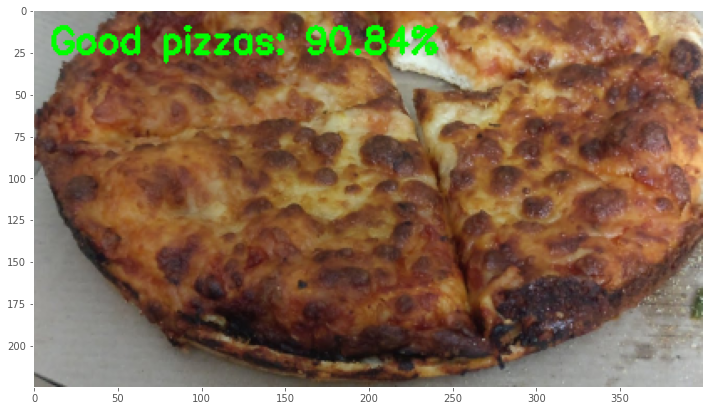

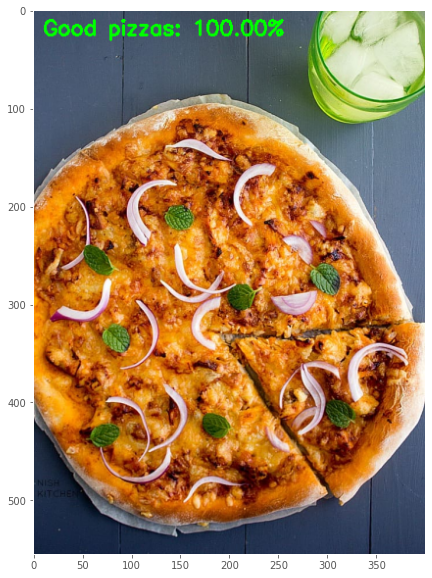

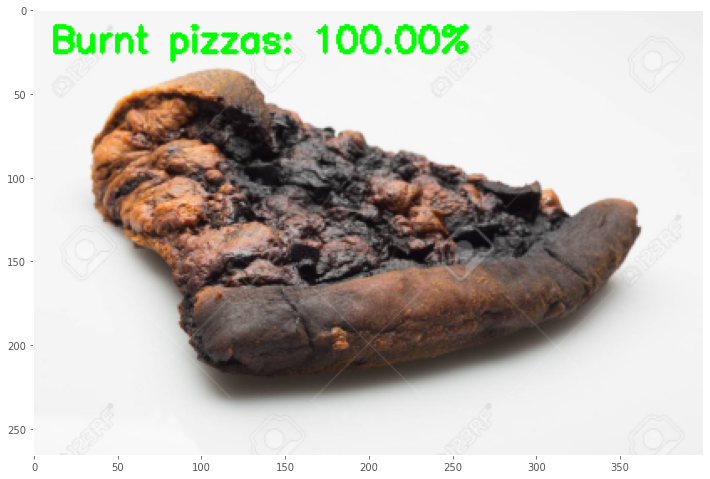

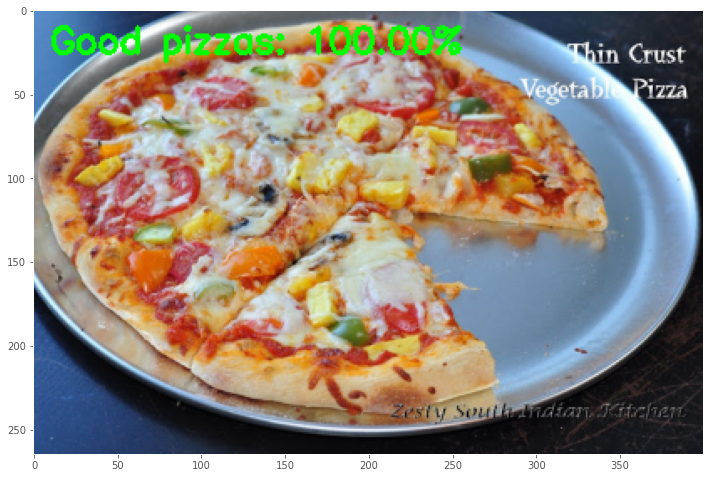

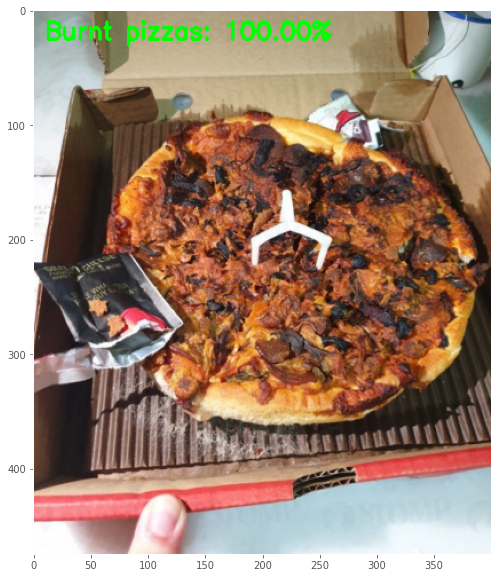

...

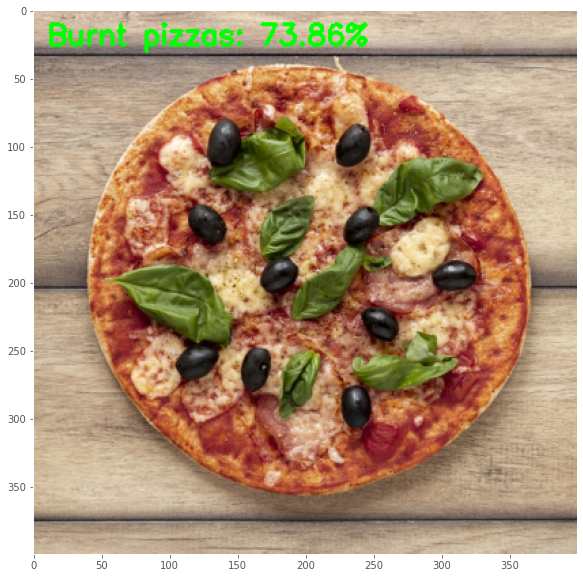

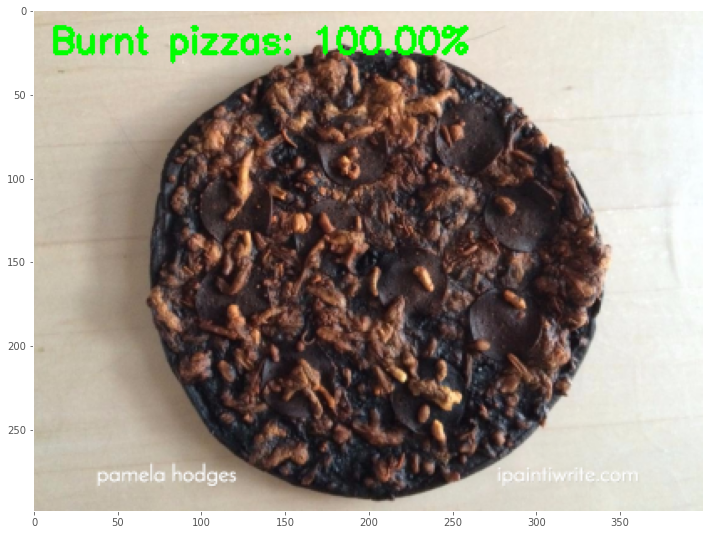

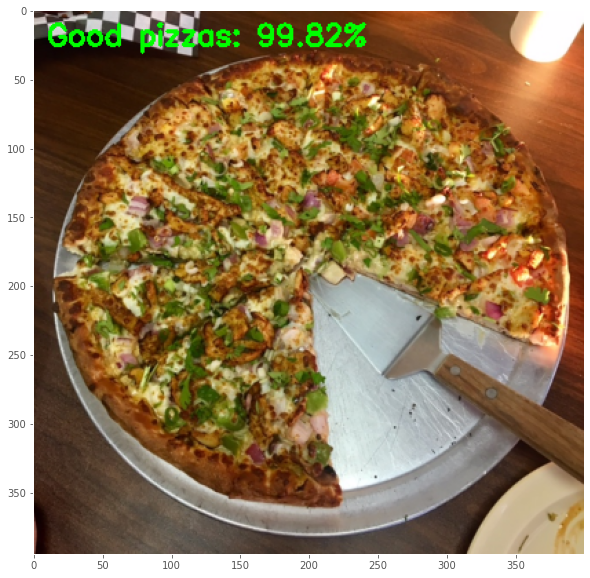

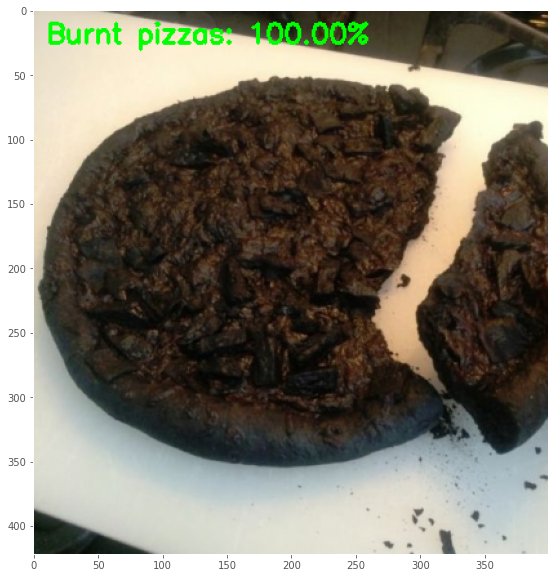

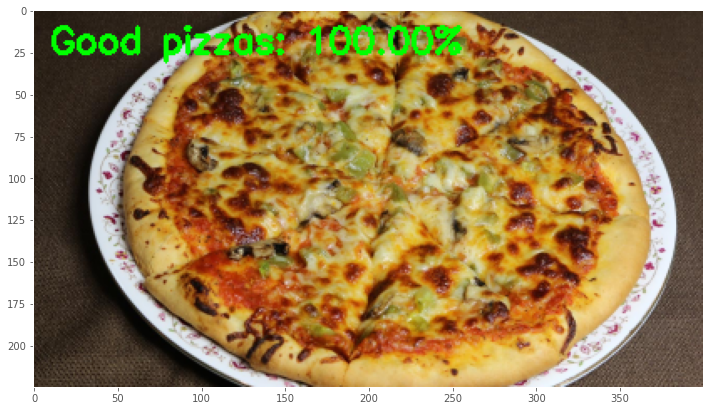

In [ ]:
# load the input image and resize it to the target spatial dimensions
width = 32
height = 32

# grab the image paths and randomly shuffle them
testImagePaths = sorted(list(paths.list_images('/content/drive/MyDrive/imarticus Exams Deep Learning/PGA Wkend DL Exam/Datasets/ANN/Pizza Refund/test')))   # test data folder with random images


# progress bar 
with tqdm(total=len(testImagePaths)) as pbar:
    
    for imagePath in testImagePaths:
        image = cv2.imread(imagePath)
        output = image.copy()
        image = cv2.resize(image, (width, height))

        # scale the pixel values to [0, 1]
        image = image.astype("float") / 255.0

        # for a simple fully-connected network, flatten the image
        image = image.flatten()
        image = image.reshape((1, image.shape[0]))


        # make a prediction on the image
        preds = model.predict(image)

        # find the class label index with the largest corresponding probability
        i = preds.argmax(axis=1)[0]
        label = classes[i]
        
        label = "{}: {:.2f}%".format(label, preds[0][i] * 100)

        
        output = imutils.resize(output, width=400)
        cv2.putText(output, label, (10, 25),  cv2.FONT_HERSHEY_SIMPLEX,
            0.7, (0, 255, 0), 2)
        
        # convert img to rgb format and display in noteboo
        img = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)
        display_img(img)

#         print("############################")
#         print("image: {}".format(os.path.split(imagePath)[-1]))
#         print("predicted label: {}".format(label))
#         print("Confidence: {}".format(preds[0][i]))
        
        pbar.update(1)